<a href="https://colab.research.google.com/github/Yashvi1701/OCR/blob/main/Cleaning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Pillow library for uploading the image, saving and minor changes
!pip install pillow

In [ ]:
from PIL import Image
im_file='Tutorial-HolePunch-02.jpg'
im=Image.open(im_file)
im.show(im_file)
print(im.size)

(1240, 1754)


In [ ]:
#Rotate the image
im1=im.rotate(180)
im1.save('01.jpg')

In [ ]:
!pip install opencv-python
!pip install tesseract
!pip install pytesseract

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.6/45.6 MB 15.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for tesseract: filename=tesseract-0.1.3-py3-none-any.whl size=45562552 sha256=0e06b6e833f2986e1cad7f46f1faa478ca89eb0a0f8875c2d3acb8c7bc2b5b2f
  Stored in directory: /root/.cache/pip/wheels/71/c9/aa/698c579693e83fdda9ad6d6f0d8f61ed986e27925ef576f109
Successfully built tesseract


In [ ]:
import cv2
import numpy as np
import pytesseract

In [ ]:
img_file='Tutorial-HolePunch-02.jpg'
img=cv2.imread(img_file)

In [ ]:
# cv2.imshow('windows',img)
# cv2.waitKey(0) #This method won't work in Jupyter Notebooks
import matplotlib.pyplot as plt
def display(im_path):
    dpi = 80 #Dots per inch
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]

    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray') #cmap=gray will display the image in grayscale

    plt.show()

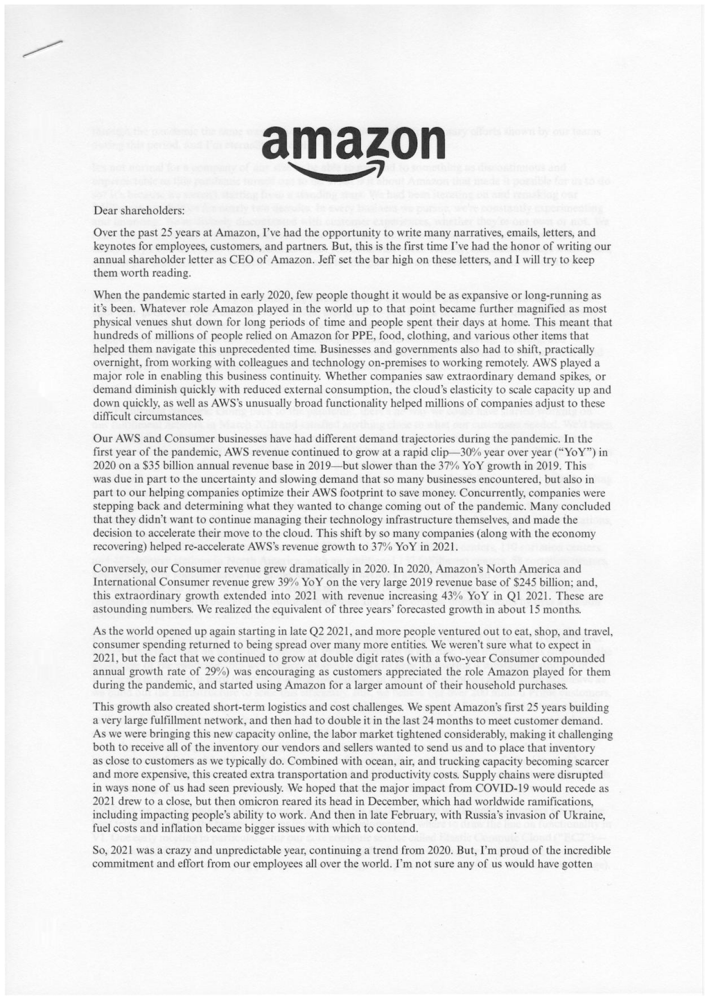

In [ ]:
display(im_file)

**INVERTED IMAGES**

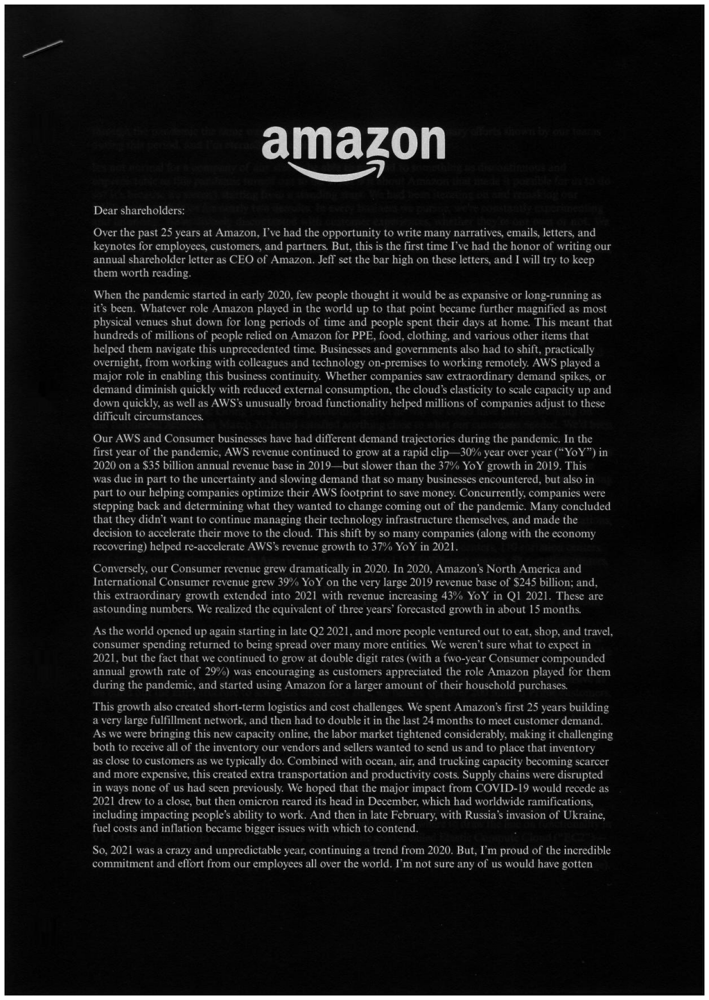

In [ ]:
inverted_image = cv2.bitwise_not(img) #Flipping each bits
cv2.imwrite("img_inverted.jpg", inverted_image)
display('img_inverted.jpg')

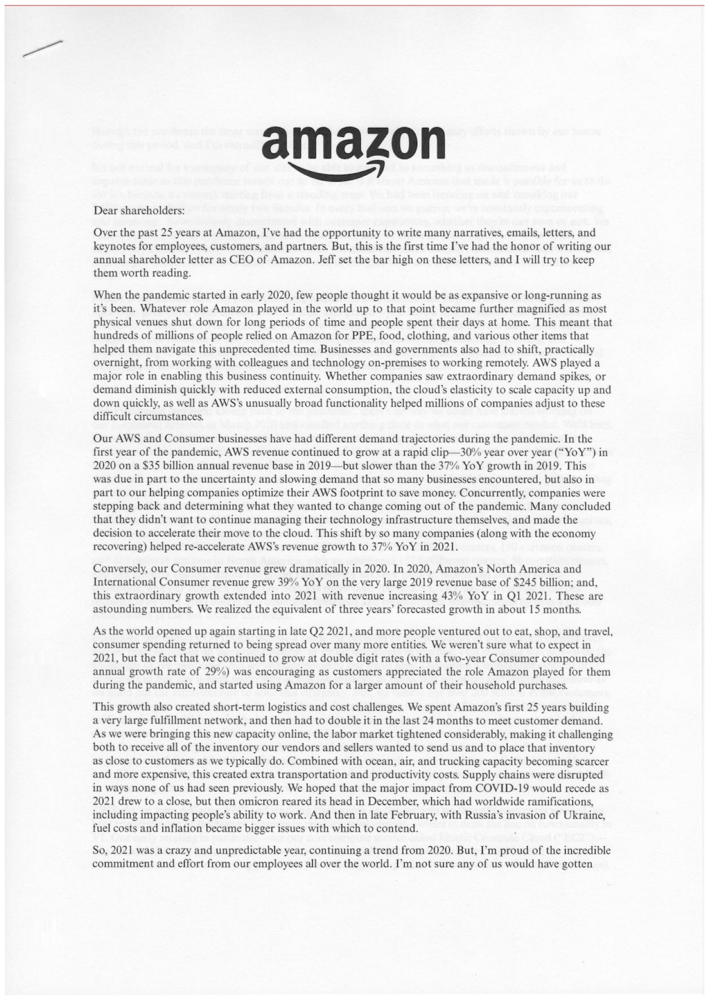

In [ ]:
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_rgb[2]=[50,50,255]
cv2.imwrite("img_RGB.jpg", img_rgb)
display('img_RGB.jpg')

**BINARIZATION**

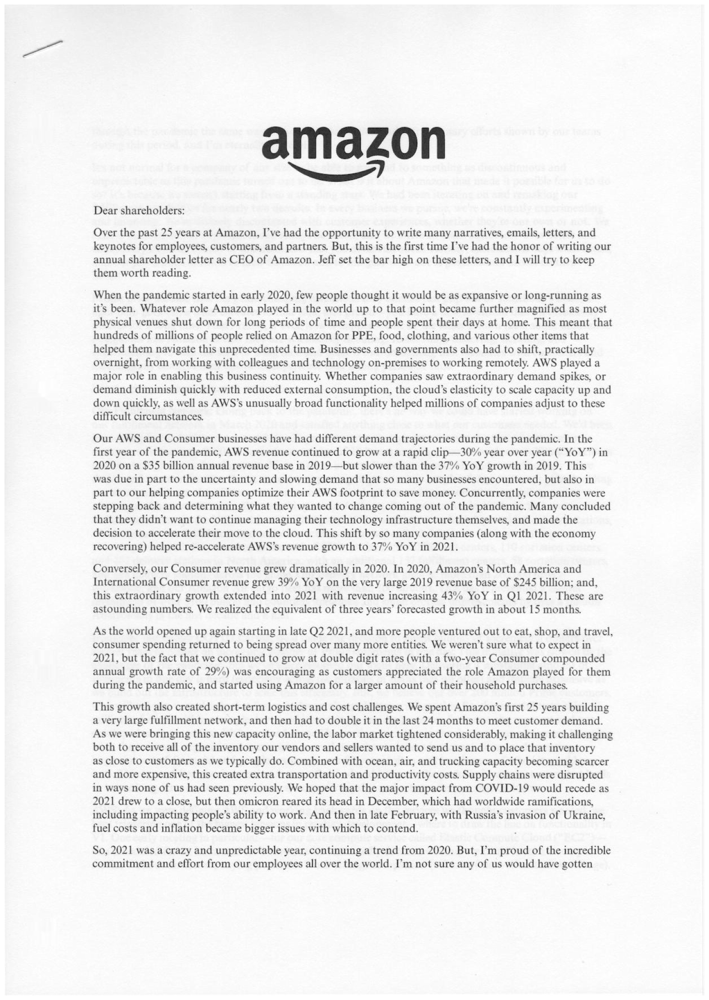

In [ ]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
gray_image = grayscale(img)
cv2.imwrite("img_gray.jpg", gray_image)

display("img_gray.jpg") #Converting image to grayscale so to implement binarization later

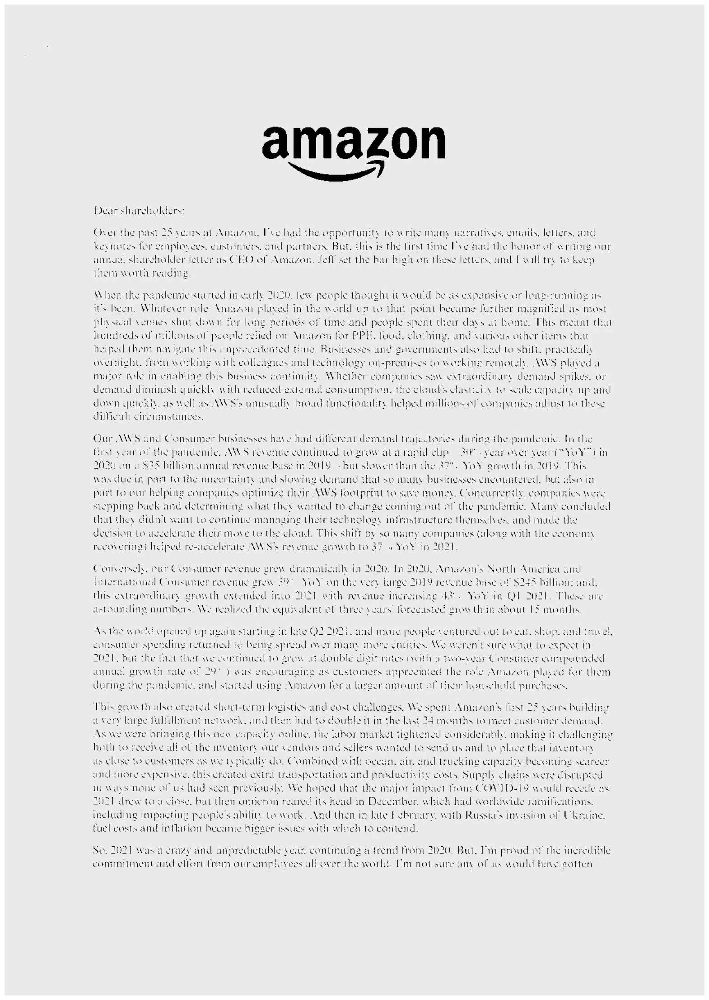

In [ ]:
thresh, im_bw_test=cv2.threshold(gray_image, 100, 100 , cv2.THRESH_BINARY)
cv2.imwrite('img_bw_test.jpg', im_bw_test)
display('img_bw_test.jpg')

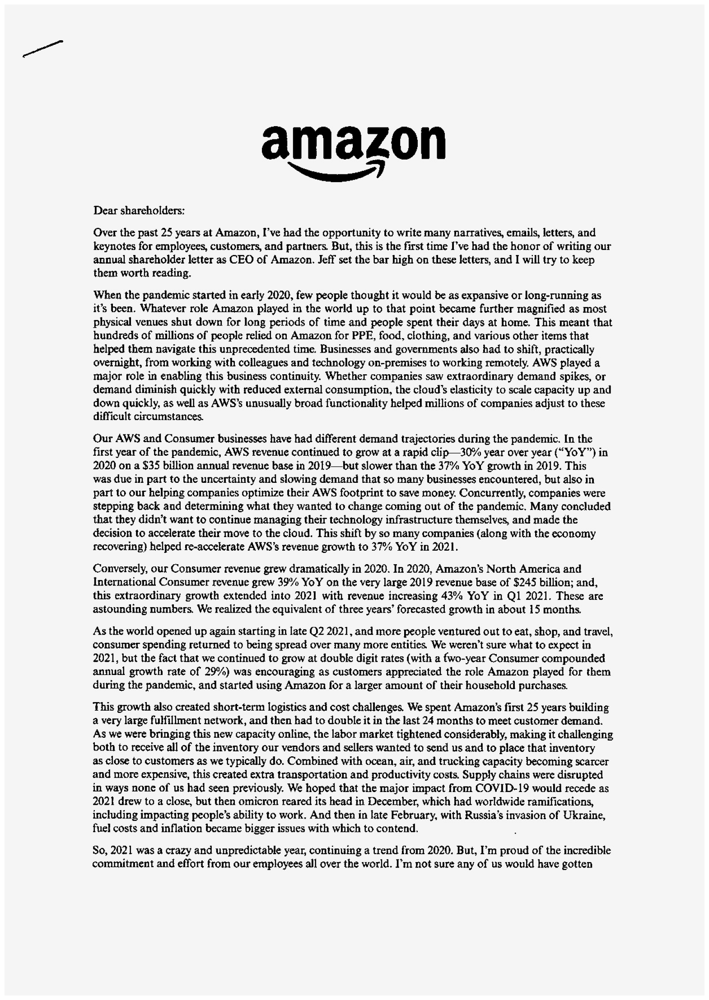

In [ ]:
thresh, im_bw=cv2.threshold(gray_image, 200, 230 , cv2.THRESH_BINARY)
cv2.imwrite('img_bw.jpg', im_bw)
display('img_bw.jpg')
# The threshold value used for binarization. In this case, pixels with intensity values below 210 will be set to 0 (black)


**NOISE REMOVAL**

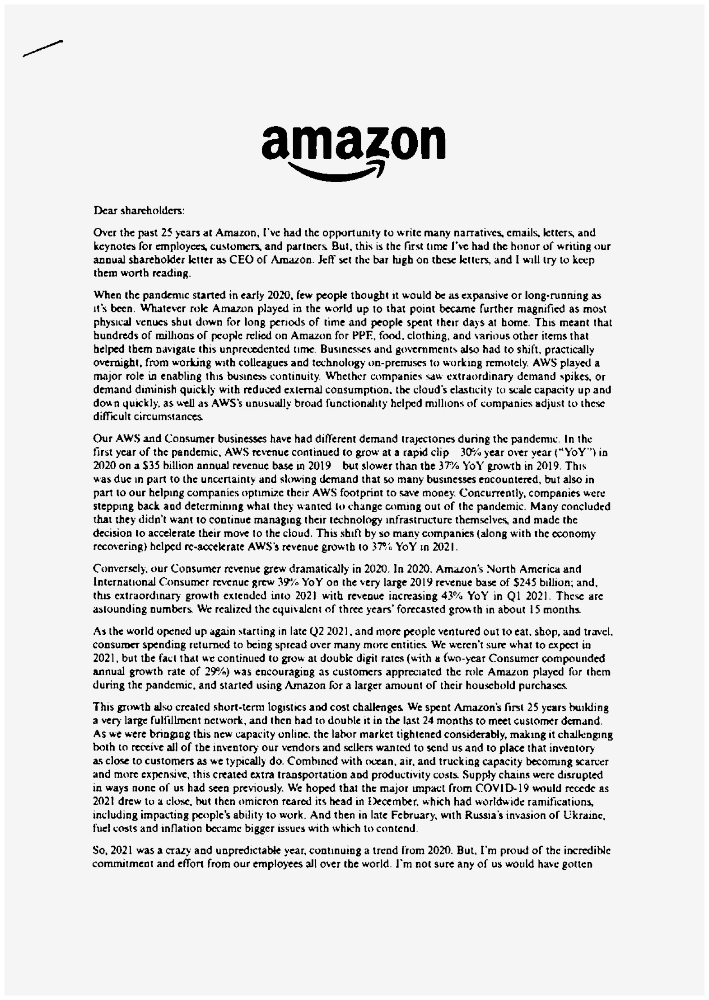

In [ ]:
def noise_removal(image):
  kernel=np.ones((1,1), np.uint8)
  image=cv2.dilate(image, kernel, iterations=1)
  kernel=np.ones((1,1), np.int8)
  image=cv2.erode(image, kernel, iterations=1)
  image=cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
  image=cv2.medianBlur(image, 3) #Use this and morph when you'have got noise in the background
  return image

no_noise = noise_removal(im_bw)
cv2.imwrite("no_noise.jpg", no_noise)
display("no_noise.jpg")
# Median blur is a non-linear filter that is effective at removing noise while preserving edges in an image.

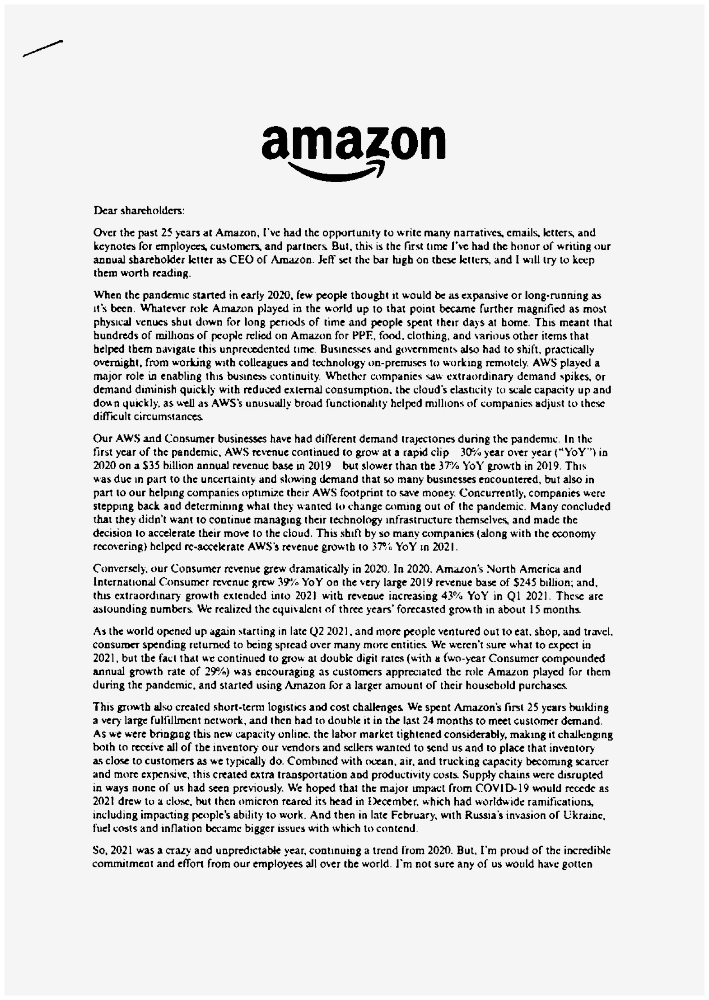

In [ ]:
#Use dilation and erosion to change the fonts with no background noise
def thin_font(image):
  image=cv2.bitwise_not(image)
  kernel=np.ones((2,2), np.uint8)
  cv2.erode(image, kernel, iterations=1)
  image=cv2.bitwise_not(image)
  return image

thin_font = thin_font(no_noise)
cv2.imwrite("thin_font.jpg", thin_font)
display("thin_font.jpg")

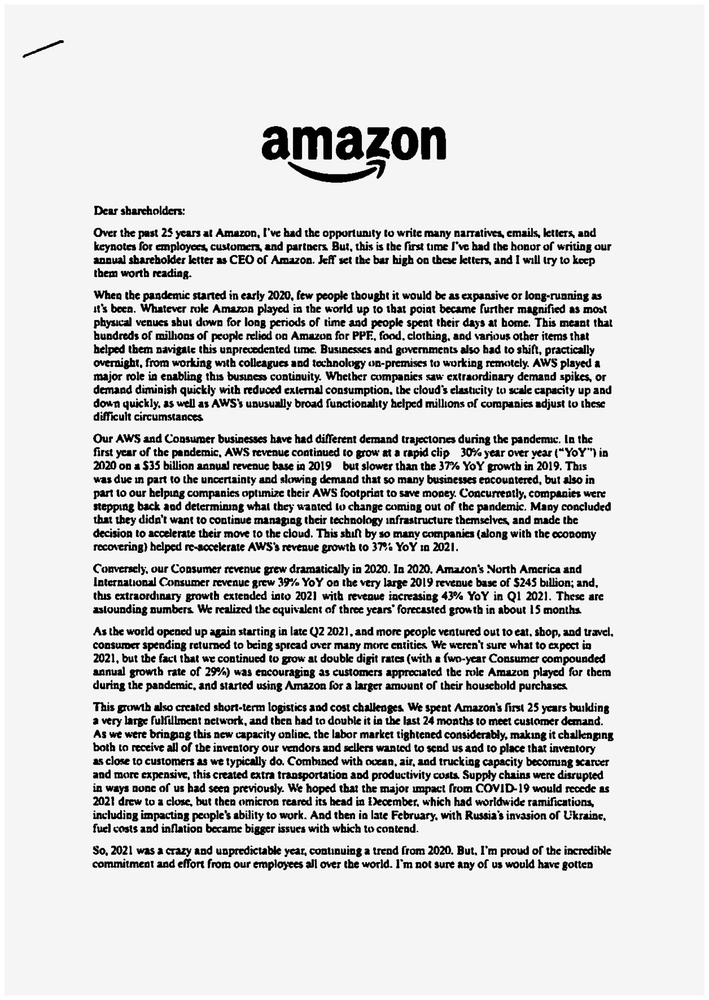

In [ ]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

dilated_image=thick_font(no_noise)
cv2.imwrite('dilated_image.jpg',dilated_image)
display('dilated_image.jpg')

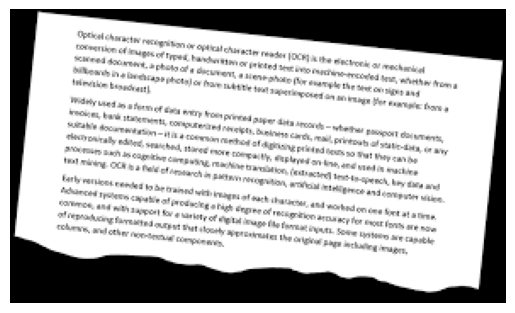

In [ ]:
#Rotation
im1=cv2.imread('images (2).png')
plt.imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)) # Convert color space for proper display with matplotlib
plt.axis('off')
plt.show()


In [ ]:
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [ ]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

2


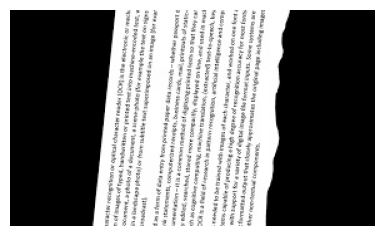

In [ ]:
fixed = deskew(im1)
cv2.imwrite("rotated_fixed.jpg", fixed)
display('rotated_fixed.jpg')

In [ ]:
#Removing borders
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

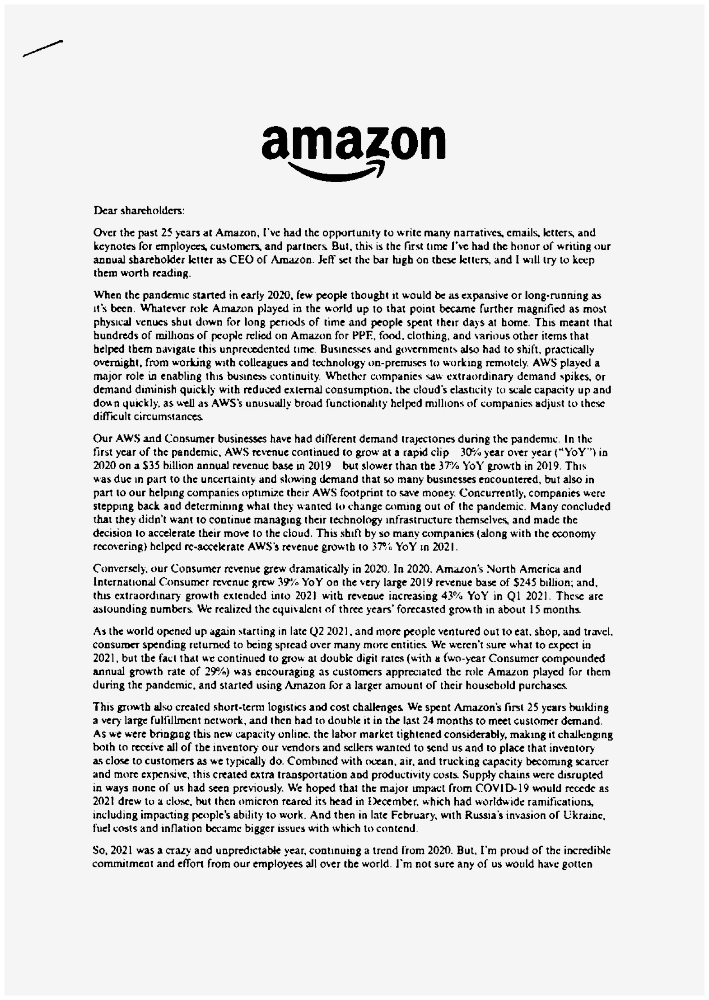

In [ ]:
no_borders = remove_borders(no_noise)
cv2.imwrite("no_borders.jpg", no_borders)
display('no_borders.jpg')

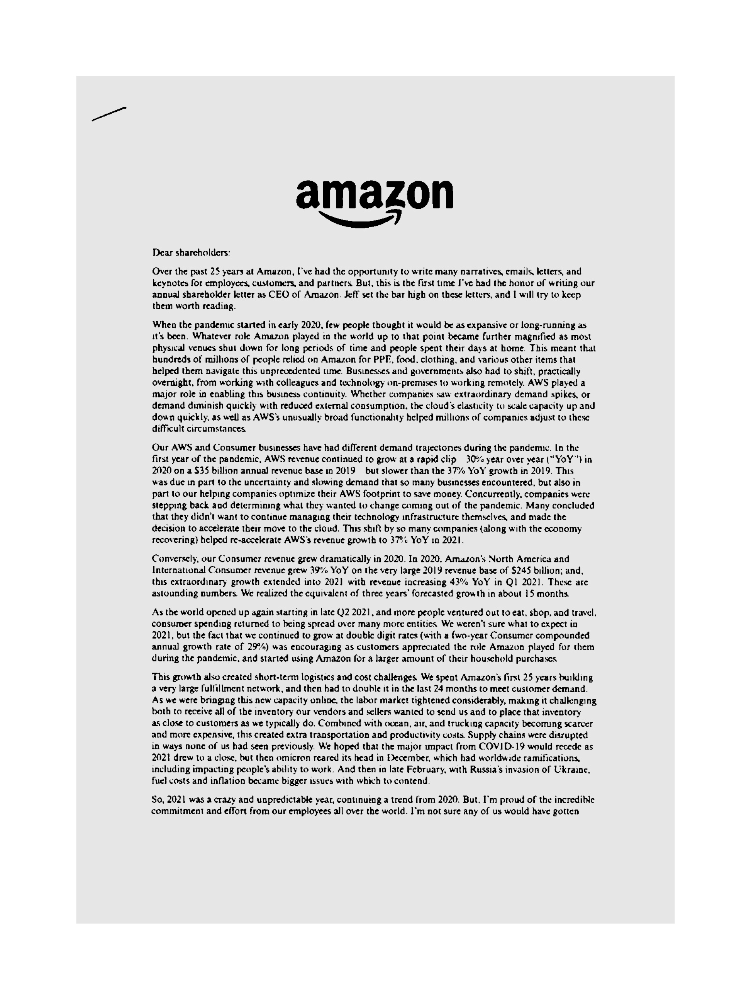

In [ ]:
#MISSING BORDERS, YOU SHOULD DO THIS WHEN TEXT IS ALL THE WAY UP BORDERS
#AS MODELS AS TRAINED WITH BORDERS
color=[255,255,255]
top, bottom, left, right=[150]*4
image_with_border=cv2.copyMakeBorder(no_borders,top,bottom,left,right,cv2.BORDER_CONSTANT,value=color)
cv2.imwrite('with_borders.jpg', image_with_border)
display('with_borders.jpg')

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load an image with alpha channel (RGBA format)
image_with_alpha = cv2.imread('Tutorial-HolePunch-02.jpg', cv2.IMREAD_UNCHANGED)

# Check if the image was successfully loaded
if image_with_alpha is None:
    print("Error: Image not loaded.")
    exit()

# Split the image into RGB channels and alpha channel
bgr = image_with_alpha[:, :, :3]  # Blue-Green-Red channels
alpha = alpha*0.5 # Alpha channel (transparency)

# Example: Increase transparency (reduce alpha values)
alpha = alpha * 0.5  # Reduce alpha values by half (make it more transparent)

# Merge RGB channels and updated alpha channel
image_with_alpha_updated = np.dstack((bgr, alpha))

# Display the original and updated images with transparency
def display_with_transparency(image_with_alpha, image_with_alpha_updated):
    # Create subplots for original and updated images
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Display original image
    ax1.imshow(cv2.cvtColor(image_with_alpha, cv2.COLOR_BGRA2RGBA))
    ax1.set_title('Original Image')
    ax1.axis('off')

    # Display updated image with transparency
    ax2.imshow(cv2.cvtColor(image_with_alpha_updated, cv2.COLOR_BGRA2RGBA))
    ax2.set_title('Updated Image with Transparency')
    ax2.axis('off')

    plt.show()

# Display the images
display_with_transparency(image_with_alpha, image_with_alpha_updated)

# Save the updated image with transparency
cv2.imwrite('image_with_alpha_updated.png', image_with_alpha_updated)
print("Updated image saved as 'image_with_alpha_updated.png'.")


IndexError: index 3 is out of bounds for axis 2 with size 3